In [19]:
import pandas as pd
from IPython.display import display
import folium
from folium.features import CustomIcon

In [20]:
df = pd.read_csv('../data/sf_trees.csv')

In [21]:
# available fruits:
# 'cherry',     'plum',          'peach',       'loquat',    'lemon', 
# 'lime',       'pomegranate',   'fig',         'pear',      'asian pear', 
# 'crabapple',  'apple',         'persimmon',   'apricot',   'avocado',
# 'mango',      'guava',         'kumquat'
wanted_trees = []
public_trees = False

In [22]:
tree_name_to_species_match = {
#     cherry
    "cherry": ["Prunus spp :: Cherry"], 
#     plum
    "plum": ["Prunus spp :: Flowering Plum"],
#     peach
    "peach": ["peach"], 
#     loquat
    "loquat": ["Eriobotrya japonica"], 
#     lemon
    "lemon": 
        ["Citrus spp :: Lemon: Orange: Lime", 
        "Citrus × meyeri 'Improved' :: Improved Meyer Lemon", 
        "Citrus × limon 'Lisbon' :: Lisbon Lemon Tree"],
#     lime
    "lime": 
        ["Citrus aurantifolia 'Bearss' :: Seedless Lime",
        "Citrus x hystrix :: Kaffir lime"],
#     pomegranate
    "pomegranate": ["Punica granatum 'Wonderfu :: Pomegranate Tree 'Wonderful'"],
#     figs
    "fig": ["Ficus carica"],
#     pear
    "pear": 
        ["Pyrus spp",
        "Bartlett Pear"],
#     asian pear
    "asian pear": ["asian pear"],
#     crabapple
    "crabapple": 
        ["Malus :: Crab Apple",
        "Malus x 'Callaway' :: White-Flowered Crabapple",
        "Malus floribunda 'Prairie Fire' :: Prairie Fire Crabapple Tree"],
#     apple
    "apple": 
        ["Malus 'Gala' :: Apple Tree 'Gala'",
        "Malus sylvestris :: Apple"],
#     Persimmon
    "persimmon": ["persimmon"],
#     Apricot
    "apricot": ["apricot"],
#     Avocado
    "avocado": ["Persea americana"],
#     Mango
    "mango": ["mango"],
#     guava
    "guava": ["guava"],
#     Kumquat
    "kumquat": ["kumquat"],
#     Strawberry Tree
    "strawberry tree": ["Arbutus unedo :: Strawberry Tree"],
    "mulberry": [""]
    
    }
tree_name_to_species_match.keys()

dict_keys(['cherry', 'plum', 'peach', 'loquat', 'lemon', 'lime', 'pomegranate', 'fig', 'pear', 'asian pear', 'crabapple', 'apple', 'persimmon', 'apricot', 'avocado', 'mango', 'guava', 'kumquat', 'strawberry tree', 'mulberry'])

In [23]:
fruit_trees = []
for fruit_name in wanted_trees:
    fruit_trees += tree_name_to_species_match[fruit_name]

if len(wanted_trees) == 0:
    fruit_trees = [fruit for sublist in tree_name_to_species_match.values() for fruit in sublist]
fruit_trees

['Prunus spp :: Cherry',
 'Prunus spp :: Flowering Plum',
 'peach',
 'Eriobotrya japonica',
 'Citrus spp :: Lemon: Orange: Lime',
 "Citrus × meyeri 'Improved' :: Improved Meyer Lemon",
 "Citrus × limon 'Lisbon' :: Lisbon Lemon Tree",
 "Citrus aurantifolia 'Bearss' :: Seedless Lime",
 'Citrus x hystrix :: Kaffir lime',
 "Punica granatum 'Wonderfu :: Pomegranate Tree 'Wonderful'",
 'Ficus carica',
 'Pyrus spp',
 'Bartlett Pear',
 'asian pear',
 'Malus :: Crab Apple',
 "Malus x 'Callaway' :: White-Flowered Crabapple",
 "Malus floribunda 'Prairie Fire' :: Prairie Fire Crabapple Tree",
 "Malus 'Gala' :: Apple Tree 'Gala'",
 'Malus sylvestris :: Apple',
 'persimmon',
 'apricot',
 'Persea americana',
 'mango',
 'guava',
 'kumquat',
 'Arbutus unedo :: Strawberry Tree',
 '']

In [24]:
fruits = df[df['qSpecies'].str.contains('strawberry tree', case=False)]
fruits = fruits.dropna(subset=['Latitude', 'Longitude'])
fruits

,TreeID,qLegalStatus,qSpecies,qAddress,SiteOrder,qSiteInfo,PlantType,qCaretaker,qCareAssistant,PlantDate,...,YCoord,Latitude,Longitude,Location,Fire Prevention Districts,Police Districts,Supervisor Districts,Zip Codes,Neighborhoods (old),Analysis Neighborhoods
0,168225,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,2547 Vallejo St,1.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,NaN,...,2.117588e+06,37.794558,-122.439869,"(37.794558498932695, -122.43986908930563)",13.0,9.0,1.0,57.0,27.0,30.0
1,168228,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,2547 Vallejo St,4.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,NaN,...,2.117593e+06,37.794575,-122.439690,"(37.79457507971764, -122.43968957023225)",13.0,9.0,1.0,57.0,27.0,30.0
5,168226,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,2547 Vallejo St,2.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,NaN,...,2.117589e+06,37.794563,-122.439812,"(37.794563104363796, -122.43981196974892)",13.0,9.0,1.0,57.0,27.0,30.0
7,168227,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,2547 Vallejo St,3.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,NaN,...,2.117591e+06,37.794570,-122.439748,"(37.794570474292, -122.43974785529267)",13.0,9.0,1.0,57.0,27.0,30.0
9,168224,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,2660 Scott St,1.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,NaN,...,2.117535e+06,37.794412,-122.439932,"(37.79441203444588, -122.43993203735376)",13.0,9.0,1.0,57.0,27.0,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197077,71994,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,400 38th Ave,4.0,Sidewalk: Curb side : Cutout,Tree,Private,FUF,11/22/1986 12:00:00 AM,...,2.113104e+06,37.781259,-122.498715,"(37.78125854547823, -122.49871492967712)",11.0,6.0,2.0,55.0,26.0,29.0
197109,219918,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,1970 Harrison St,5.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,NaN,...,2.106906e+06,37.765653,-122.413261,"(37.76565258053813, -122.41326053406084)",8.0,4.0,7.0,28853.0,19.0,20.0
197140,72012,DPW Maintained,Arbutus 'Marina' :: Hybrid Strawberry Tree,2232 Ortega St,2.0,Sidewalk: Curb side : Cutout,Tree,Private,FUF,12/16/1995 12:00:00 AM,...,2.102367e+06,37.751950,-122.487752,"(37.751950463118305, -122.48775176822542)",1.0,8.0,3.0,56.0,35.0,35.0
197163,204769,Permitted Site,Arbutus 'Marina' :: Hybrid Strawberry Tree,1468 17th Ave,1.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,04/19/2002 12:00:00 AM,...,2.105420e+06,37.760558,-122.474612,"(37.76055774634118, -122.47461165018507)",1.0,8.0,4.0,56.0,12.0,14.0


In [13]:
fruits['qSpecies'].value_counts()

qSpecies
Arbutus 'Marina' :: Hybrid Strawberry Tree           5693
Arbutus unedo :: Strawberry Tree                      630
Arbutus unedo 'Compacta' :: Dwarf strawberry tree       4
Name: count, dtype: int64

In [275]:
# tree specifics
tree_info = {
#     Cherry
    "Prunus spp :: Cherry": {
        "popup_title": "Cherry tree",
        "image_path": '../resources/cherry.png',
        "icon_size": (25, 25),
    },
#     Plum
    "Prunus spp :: Flowering Plum": {
        "popup_title": "Plum tree",
        "image_path": '../resources/plum.png',
        "icon_size": (20, 20),
    },
#     Peach
    "Prunus persica :: Peach": {
        "popup_title": "Peach tree",
        "image_path": '../resources/peach.png',
        "icon_size": (20, 20),
    },
#     Loquat
    "Eriobotrya japonica :: Edible Loquat": {
        "popup_title": "Loquat tree",
        "image_path": '../resources/loquat.png',
        "icon_size": (20, 20),
    },
#     Citrus/Lemon
    "Citrus spp :: Lemon: Orange: Lime": {
        "popup_title": "Citrus (probably lemon) tree",
        "image_path": '../resources/lemon.png',
        "icon_size": (25, 25),
    },
    "Citrus × meyeri 'Improved' :: Improved Meyer Lemon": {
        "popup_title": "Meyer Lemon tree",
        "image_path": '../resources/lemon.png',
        "icon_size": (25, 25),
    },
    "Citrus × limon 'Lisbon' :: Lisbon Lemon Tree": {
        "popup_title": "Lemon tree",
        "image_path": '../resources/lemon.png',
        "icon_size": (25, 25),
    },
#     Lime
    "Citrus aurantifolia 'Bearss' :: Seedless Lime": {
        "popup_title": "Lime tree",
        "image_path": '../resources/lime.png',
        "icon_size": (25, 25),
    },
    "Citrus x hystrix :: Kaffir lime": {
        "popup_title": "Kaffir Lime tree",
        "image_path": '../resources/lime.png',
        "icon_size": (25, 25),
    },
#    Pomegranate 
    "Punica granatum 'Wonderfu :: Pomegranate Tree 'Wonderful'": {
        "popup_title": "Pomegranate tree",
        "image_path": '../resources/pomegranate.png',
        "icon_size": (25, 25),
    },
#     Fig
    "Ficus carica :: Edible Fig": {
        "popup_title": "Fig tree",
        "image_path": '../resources/fig.png',
        "icon_size": (25, 25),
    },
    "Ficus carica 'Black Mission' :: Black Mission Fig": {
        "popup_title": "Fig (Black Mission) tree",
        "image_path": '../resources/fig.png',
        "icon_size": (25, 25),
    },
    "Ficus carica 'Brown Turkey' :: Brown Turkey Fig": {
        "popup_title": "Fig (Brown Turkey) tree",
        "image_path": '../resources/fig.png',
        "icon_size": (25, 25),
    },
#     Pear
    "Pyrus spp :: Pear Tree": {
        "popup_title": "Pear tree",
        "image_path": '../resources/pear.png',
        "icon_size": (25, 25),
    },
    "Pyrus x 'Bartlett' :: Bartlett Pear": {
        "popup_title": "Pear (Barlett) tree",
        "image_path": '../resources/pear.png',
        "icon_size": (25, 25),
    },
    "Pyrus pyrifolia '20th Century' :: Asian Pear '20th Century'": {
        "popup_title": "Asian Pear tree",
        "image_path": '../resources/asian-pear.png',
        "icon_size": (25, 25),
    },
    "Pyrus pyrifolia 'Sainseiki' :: Asian Pear 'Sainseiki'": {
        "popup_title": "Asian Pear tree",
        "image_path": '../resources/asian-pear.png',
        "icon_size": (25, 25),
    },
#     Crabapple
    "Malus :: Crab Apple": {
        "popup_title": "Crabapple tree",
        "image_path": '../resources/crabapple.png',
        "icon_size": (25, 25),
    },
    "Malus x 'Callaway' :: White-Flowered Crabapple": {
        "popup_title": "Crabapple tree",
        "image_path": '../resources/crabapple.png',
        "icon_size": (25, 25),
    },
    "Malus floribunda 'Prairie Fire' :: Prairie Fire Crabapple Tree": {
        "popup_title": "Crabapple tree",
        "image_path": '../resources/crabapple.png',
        "icon_size": (25, 25),
    },
#     Apple
    "Malus 'Gala' :: Apple Tree 'Gala'": {
        "popup_title": "Apple (Gala) tree",
        "image_path": '../resources/apple.png',
        "icon_size": (25, 25),
    },
    "Malus sylvestris :: Apple": {
        "popup_title": "Apple tree",
        "image_path": '../resources/apple.png',
        "icon_size": (25, 25),
    },
#     Persimmon
    "Diospyros kaki :: Persimmon": {
        "popup_title": "Persimmon tree",
        "image_path": '../resources/persimmon.png',
        "icon_size": (25, 25),
    },
#     Apricot
    "Prunus armeniaca :: Apricot": {
        "popup_title": "Apricot tree",
        "image_path": '../resources/apricot.png',
        "icon_size": (20, 20),
    },
#     Avocado
    "Persea americana :: Avocado": {
        "popup_title": "Avocado tree",
        "image_path": '../resources/avocado.png',
        "icon_size": (20, 20),
    },
    "Persea americana 'Stewart' :: Stewart Avocado": {
        "popup_title": "Avocado tree",
        "image_path": '../resources/avocado.png',
        "icon_size": (20, 20),
    },
#     Mango
    "Mangifera indica :: Mango": {
        "popup_title": "Mango tree",
        "image_path": '../resources/mango.png',
        "icon_size": (25, 25),
    },
#     Guava
    "Psidium guajava :: Guava tree": {
        "popup_title": "Guava tree",
        "image_path": '../resources/guava.png',
        "icon_size": (25, 25),
    },
    "Acca sellowiana :: Pineapple Guava Tree": {
        "popup_title": "Guava (Pineapple) tree",
        "image_path": '../resources/guava.png',
        "icon_size": (25, 25),
    },
#     Kumquat
    "Fortunella margarita :: Kumquat": {
        "popup_title": "Kumquat tree",
        "image_path": '../resources/kumquat.png',
        "icon_size": (25, 25),
    },
}



In [276]:
# Create a map centered on San Francisco
latitude_center = 37.7749
longitude_center = -122.4194
map_center = [latitude_center, longitude_center]
map_zoom = 12.5  # Adjust the zoom level as needed
map_obj = folium.Map(location=map_center, zoom_start=map_zoom)

# Add markers with custom icons for each point
for index, row in fruits.iterrows():
    latitude = row['Latitude']
    longitude = row['Longitude']
    address = row["qAddress"]
    
    image_path = tree_info[row['qSpecies']]['image_path']
    popup_title = tree_info[row['qSpecies']]['popup_title']
    icon_size = tree_info[row['qSpecies']]['icon_size']
    maps_link = f"http://www.google.com/maps/place/{latitude},{longitude}"
    plant_date = row["PlantDate"]
    caretaker = row["qCaretaker"]
    
    # Define the path to the image file
    icon = CustomIcon(
            icon_image=image_path,
            icon_size=icon_size,  # Adjust the size as needed
#             icon_anchor=(25, 25),  # Adjust the anchor position as needed
        )

    marker = folium.Marker(
        location=[latitude, longitude], 
        icon=icon,
        tooltip=popup_title
    )
    
    popup_content = f"<strong>{popup_title}</strong><br><strong>Address:</strong> {address}<br><strong>Public/Private:</strong> {caretaker}<br><strong>Plant date:</strong> {plant_date}<br><strong>Google Maps URL:</strong> {maps_link}"
    popup = folium.Popup(popup_content)  # Adjust max_width as needed
    marker.add_child(popup)
    
    marker.add_to(map_obj)

# Display the map



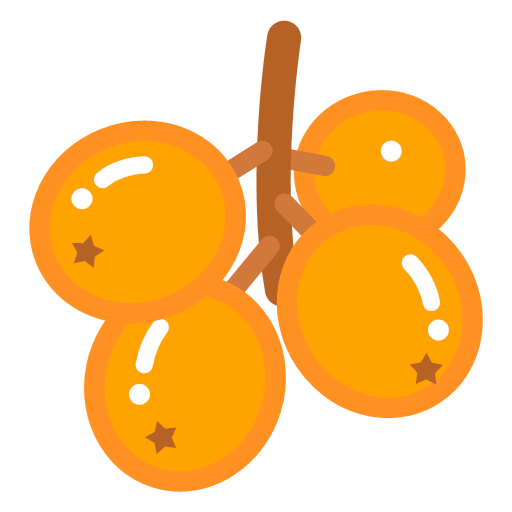
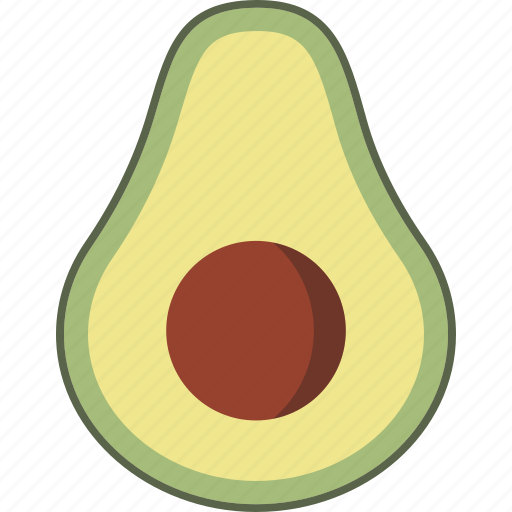
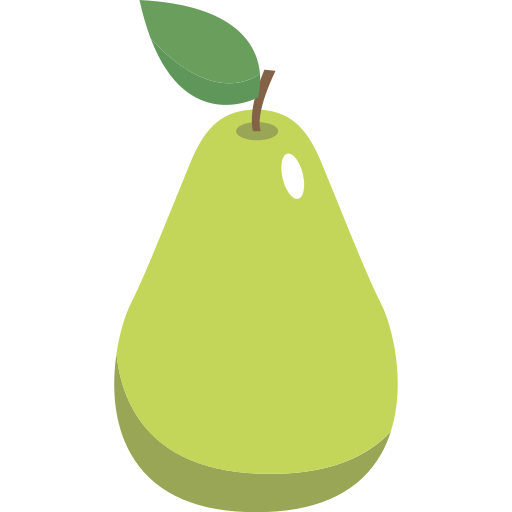
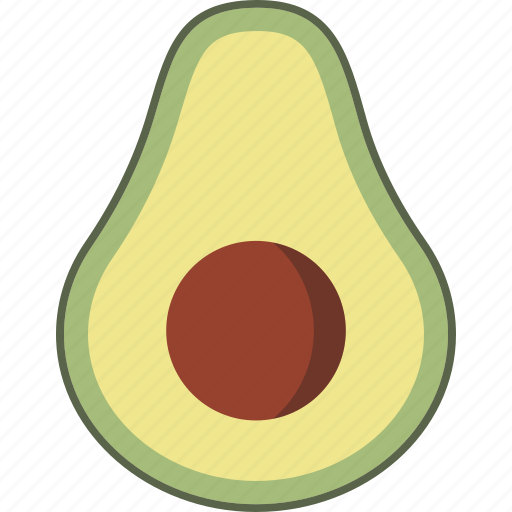
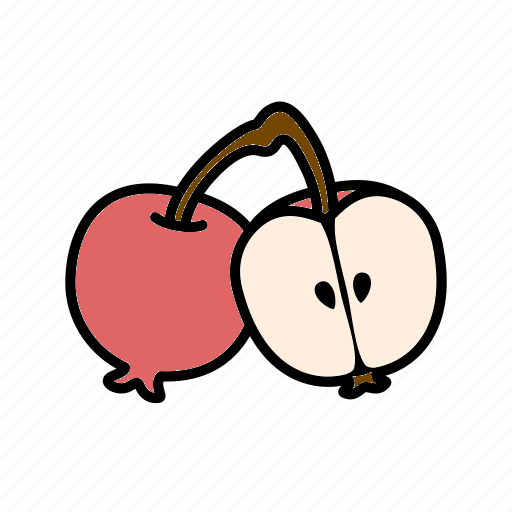
...
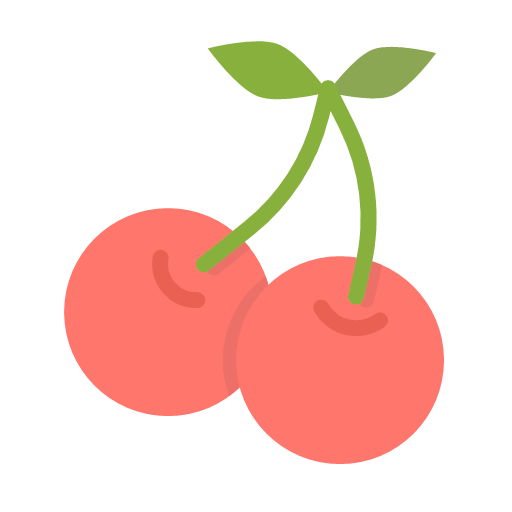
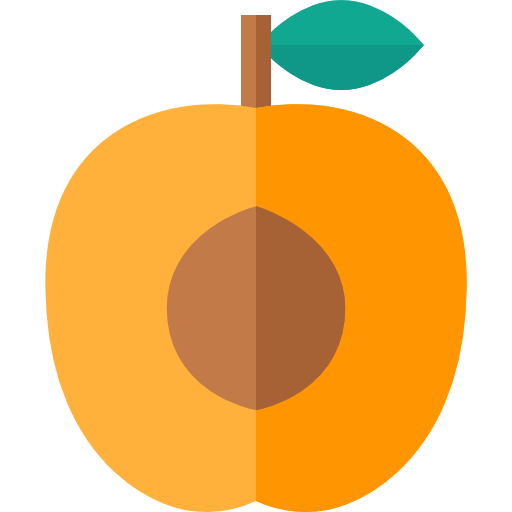
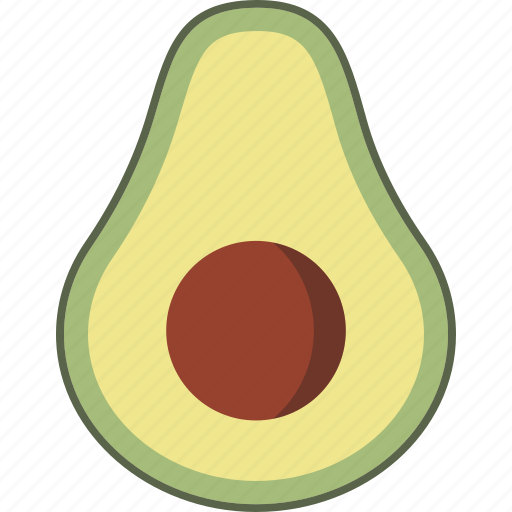
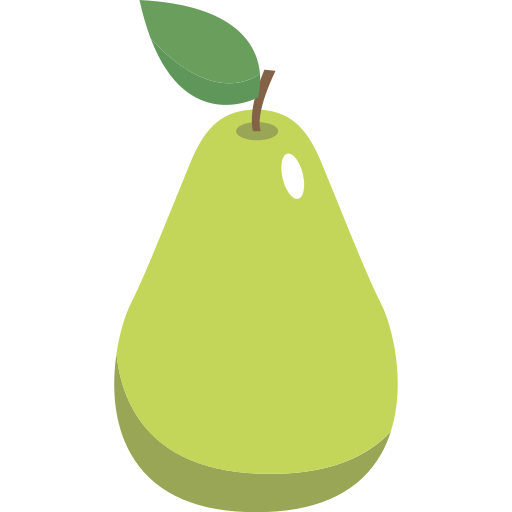
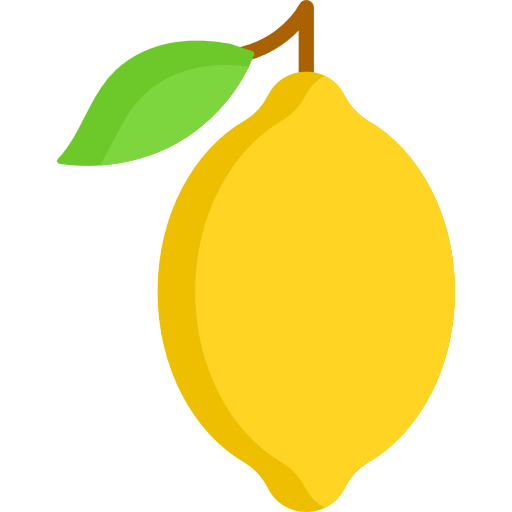

In [277]:
map_obj

In [130]:
map_file = '../maps/fruit_map_all.html'
map_obj.save(map_file)

In [243]:
fruits

,TreeID,qLegalStatus,qSpecies,qAddress,SiteOrder,qSiteInfo,PlantType,qCaretaker,qCareAssistant,PlantDate,...,YCoord,Latitude,Longitude,Location,Fire Prevention Districts,Police Districts,Supervisor Districts,Zip Codes,Neighborhoods (old),Analysis Neighborhoods
204,253287,Planning Code 138.1 required,Eriobotrya japonica :: Edible Loquat,1237 Shafter Ave,1.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,08/16/2017 12:00:00 AM,...,2.092719e+06,37.727152,-122.383991,"(37.72715205932018, -122.38399050647831)",10.0,3.0,8.0,58.0,1.0,1.0
549,233917,Significant Tree,Persea americana :: Avocado,1011 South Van Ness Ave,1.0,Front Yard : Yard,Tree,Private,NaN,NaN,...,2.103742e+06,37.756906,-122.416574,"(37.75690556746696, -122.41657376867404)",2.0,4.0,7.0,28859.0,19.0,20.0
2642,197067,DPW Maintained,Pyrus spp :: Pear Tree,1700 Armstrong Ave,1.0,Side Yard : Yard,Tree,Private,NaN,NaN,...,2.092875e+06,37.727417,-122.394152,"(37.72741700258345, -122.39415245329461)",10.0,3.0,8.0,58.0,1.0,1.0
2650,256626,DPW Maintained,Persea americana :: Avocado,2 Fallon Pl,3.0,Sidewalk: Curb side : Yard,Tree,Private,NaN,NaN,...,2.118597e+06,37.797768,-122.413141,"(37.79776759607836, -122.4131407006827)",3.0,1.0,10.0,308.0,21.0,21.0
2714,208888,DPW Maintained,Malus :: Crab Apple,747 Detroit St,10.0,Side Yard : Yard,Tree,Private,NaN,NaN,...,2.095406e+06,37.733551,-122.444410,"(37.7335508582727, -122.44440972944138)",9.0,7.0,4.0,59.0,40.0,41.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196004,40428,Permitted Site,Prunus spp :: Cherry,29 Colby St,1.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,06/03/1999 12:00:00 AM,...,2.094049e+06,37.730312,-122.414748,"(37.73031150875043, -122.41474830177664)",9.0,3.0,7.0,309.0,28.0,25.0
196191,202089,DPW Maintained,Prunus armeniaca :: Apricot,1 Gould St,17.0,Sidewalk: Curb side : Yard,Tree,Private,NaN,NaN,...,2.091145e+06,37.722610,-122.397681,"(37.72261003540794, -122.39768065196206)",10.0,3.0,8.0,58.0,1.0,1.0
196870,255607,Undocumented,Persea americana :: Avocado,347 San Carlos St,1.0,Sidewalk: Curb side : Cutout,Tree,Private,NaN,NaN,...,2.104097e+06,37.757831,-122.419665,"(37.7578313031701, -122.41966515868941)",2.0,4.0,7.0,28859.0,19.0,20.0
196941,94622,Permitted Site,Pyrus spp :: Pear Tree,1769 Armstrong Ave,1.0,Sidewalk: Property side : Cutout,Tree,Private,NaN,10/13/2010 12:00:00 AM,...,2.092727e+06,37.727020,-122.393619,"(37.7270202245482, -122.39361929372565)",10.0,3.0,8.0,58.0,1.0,1.0
